In [7]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
%load_ext autoreload
%load_ext line_profiler
%load_ext snakeviz
%autoreload 2

import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import corner

import pickle

import enterprise
from enterprise.pulsar import Pulsar
import enterprise.signals.parameter as parameter
from enterprise.signals import utils
from enterprise.signals import signal_base
from enterprise.signals import selections
from enterprise.signals.selections import Selection
from enterprise.signals import white_signals
from enterprise.signals import gp_signals
from enterprise.signals import deterministic_signals
import enterprise.constants as const

from enterprise_extensions import deterministic

from scipy.stats import norm

import libstempo as T2
import libstempo.toasim as LT
import libstempo.plot as LP

import glob
import json
import h5py
import healpy as hp
import scipy.constants as sc
import emcee

from numba.typed import List

from statsmodels.stats.weightstats import DescrStatsW

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
The line_profiler extension is already loaded. To reload it, use:
  %reload_ext line_profiler
The snakeviz extension is already loaded. To reload it, use:
  %reload_ext snakeviz


In [8]:
#load psr pickles

#make sure this points to the same pickled pulsars we used for the MCMC
data_pkl = '../data/nanograv_11yr_psrs.pkl'

#with open('nanograv_11yr_psrs_old.pkl', 'rb') as psr_pkl:
with open(data_pkl, 'rb') as psr_pkl:
    psrs = pickle.load(psr_pkl)
    
print(len(psrs))

34


# Load run + general diagnostics

In [129]:
#load results from HDF5 file

hdf_file = "../results/quickCW_test17.h5"

with h5py.File(hdf_file, 'r') as f:
    print(list(f.keys()))
    #samples_cold = f['samples_cold'][::10,:]
    print(f['samples_cold'].dtype)
    samples = f['samples_cold'][...]
    #log_likelihood = f['log_likelihood'][:,::10]
    print(f['log_likelihood'].dtype)
    log_likelihood = f['log_likelihood'][...]
    par_names = [x.decode('UTF-8') for x in list(f['par_names'])]
    acc_fraction = f['acc_fraction'][...]
    fisher_diag = f['fisher_diag'][...]

print('Acceptance fraction #columns: chain number; rows: proposal type (for morphologiacal parameters:  w/o and w/ prior draws in projection parameters) (dist-prior, dist-DE, dist-fisher, RN-prior, RN-DE, RN-fisher, common-prior, common-DE, common-fisher, PT, proj):')
#print(acc_fraction)
print(acc_fraction[:,:])
print(samples.shape)
samples_cold = np.copy(samples[0,:,::])
print(samples_cold.shape)
#print(par_names)

['T-ladder', 'acc_fraction', 'fisher_diag', 'log_likelihood', 'par_names', 'samples_cold', 'samples_freq']
float32
float64
Acceptance fraction #columns: chain number; rows: proposal type (for morphologiacal parameters:  w/o and w/ prior draws in projection parameters) (dist-prior, dist-DE, dist-fisher, RN-prior, RN-DE, RN-fisher, common-prior, common-DE, common-fisher, PT, proj):
[[2.42070117e-02 1.23456790e-02 4.87012987e-03 1.66944908e-03
  1.96094452e-03]
 [3.52253756e-01 3.84362140e-01 3.58766234e-01 3.22203673e-01
  2.75104175e-01]
 [4.31259045e-02 1.36388434e-02 4.52616690e-03 2.79955207e-03
             nan]
 [2.56150507e-01 2.49045281e-01 2.27722772e-01 2.30963046e-01
             nan]
 [5.37890461e-02 1.55313351e-02 4.80967432e-03 3.29534532e-03
             nan]
 [4.79618994e-01 4.64713896e-01 4.17479731e-01 3.54936153e-01
             nan]
 [           nan            nan            nan            nan
             nan]
 [           nan            nan            nan           

Text(0, 0.5, 'Acceptance rate')

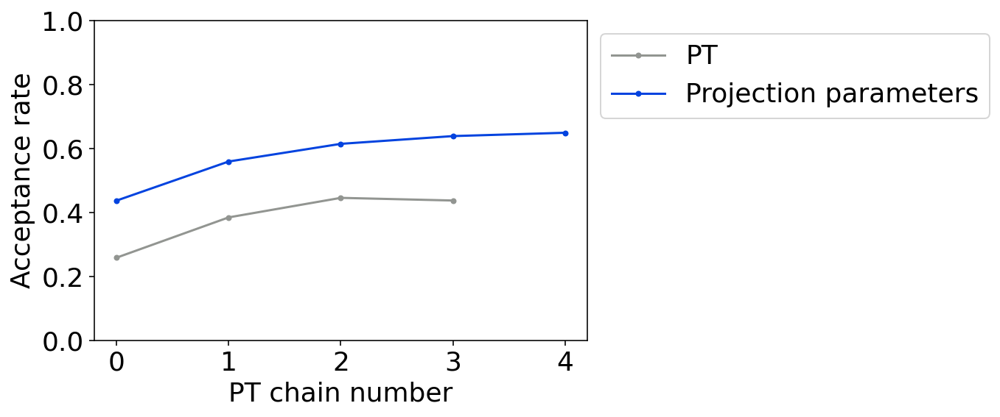

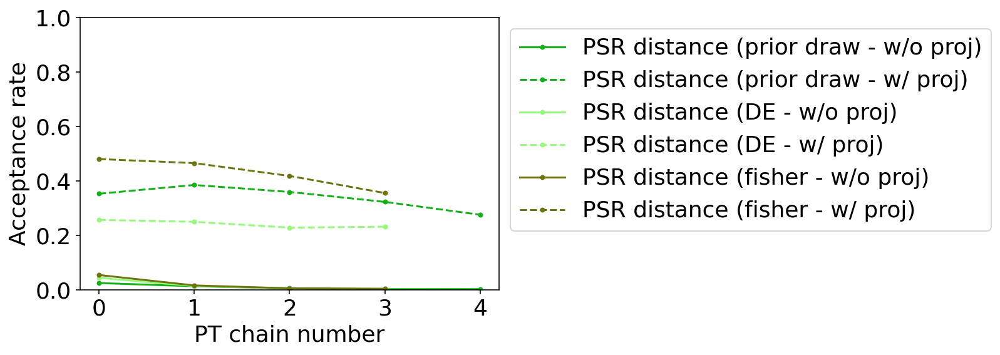

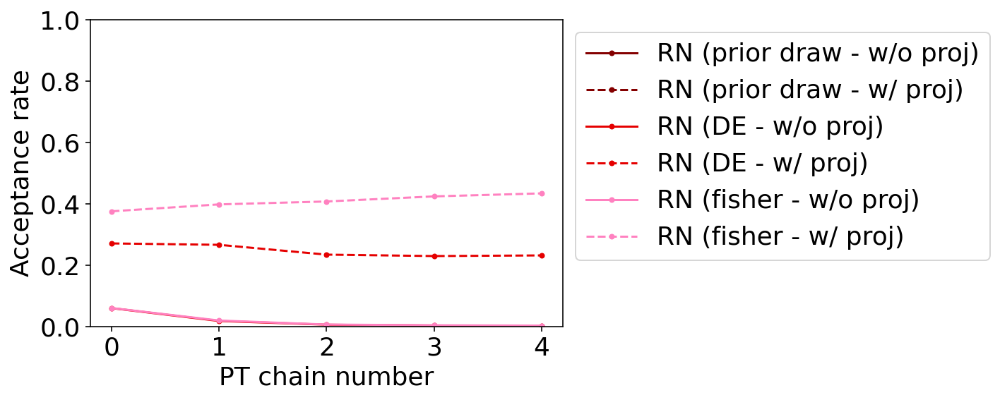

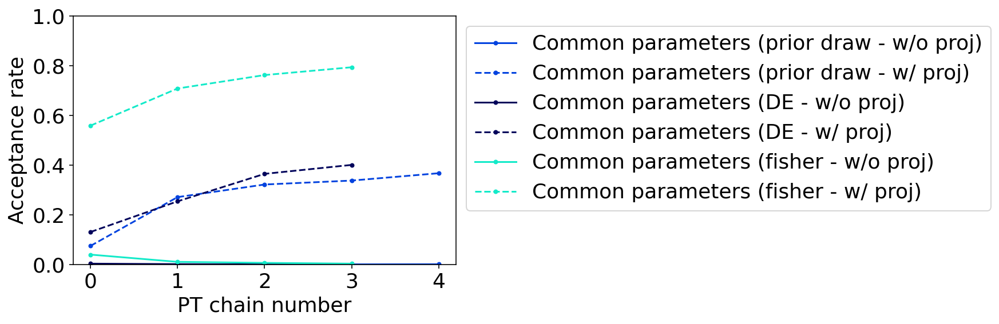

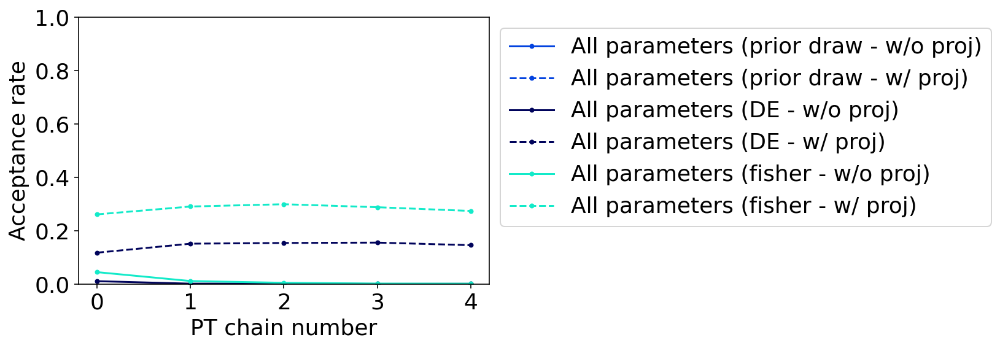

In [130]:
#Plot acceptance fraction for different kinds of steps as a function of PT chain - good for checking is run is okay

plt.figure(0)
plt.plot(acc_fraction[-2,:], color='xkcd:grey', ls='-', marker='.', label="PT")
plt.plot(acc_fraction[-1,:], color='xkcd:blue', ls='-', marker='.', label="Projection parameters")
plt.ylim(0,1)
plt.legend(bbox_to_anchor=(1,1), loc="upper left")
plt.xlabel("PT chain number")
plt.ylabel("Acceptance rate")


plt.figure(1)
plt.plot(acc_fraction[0,:], color='xkcd:green', ls='-', marker='.', label="PSR distance (prior draw - w/o proj)")
plt.plot(acc_fraction[1,:], color='xkcd:green', ls='--', marker='.', label="PSR distance (prior draw - w/ proj)")
plt.plot(acc_fraction[2,:], color='xkcd:light green', ls='-', marker='.', label="PSR distance (DE - w/o proj)")
plt.plot(acc_fraction[3,:], color='xkcd:light green', ls='--', marker='.', label="PSR distance (DE - w/ proj)")
plt.plot(acc_fraction[4,:], color='xkcd:olive', ls='-', marker='.', label="PSR distance (fisher - w/o proj)")
plt.plot(acc_fraction[5,:], color='xkcd:olive', ls='--', marker='.', label="PSR distance (fisher - w/ proj)")
plt.ylim(0,1)
plt.legend(bbox_to_anchor=(1,1), loc="upper left")
plt.xlabel("PT chain number")
plt.ylabel("Acceptance rate")


plt.figure(2)
plt.plot(acc_fraction[6,:], color='xkcd:dark red', ls='-', marker='.', label="RN (prior draw - w/o proj)")
plt.plot(acc_fraction[7,:], color='xkcd:dark red', ls='--', marker='.', label="RN (prior draw - w/ proj)")
plt.plot(acc_fraction[8,:], color='xkcd:red', ls='-', marker='.', label="RN (DE - w/o proj)")
plt.plot(acc_fraction[9,:], color='xkcd:red', ls='--', marker='.', label="RN (DE - w/ proj)")
plt.plot(acc_fraction[10,:], color='xkcd:pink', ls='-', marker='.', label="RN (fisher - w/o proj)")
plt.plot(acc_fraction[11,:], color='xkcd:pink', ls='--', marker='.', label="RN (fisher - w/ proj)")
plt.ylim(0,1)
plt.legend(bbox_to_anchor=(1,1), loc="upper left")
plt.xlabel("PT chain number")
plt.ylabel("Acceptance rate")


plt.figure(3)
plt.plot(acc_fraction[12,:], color='xkcd:blue', ls='-', marker='.', label="Common parameters (prior draw - w/o proj)")
plt.plot(acc_fraction[13,:], color='xkcd:blue', ls='--', marker='.', label="Common parameters (prior draw - w/ proj)")
plt.plot(acc_fraction[14,:], color='xkcd:dark blue', ls='-', marker='.', label="Common parameters (DE - w/o proj)")
plt.plot(acc_fraction[15,:], color='xkcd:dark blue', ls='--', marker='.', label="Common parameters (DE - w/ proj)")
plt.plot(acc_fraction[16,:], color='xkcd:aqua', ls='-', marker='.', label="Common parameters (fisher - w/o proj)")
plt.plot(acc_fraction[17,:], color='xkcd:aqua', ls='--', marker='.', label="Common parameters (fisher - w/ proj)")
plt.ylim(0,1)
plt.legend(bbox_to_anchor=(1,1), loc="upper left")
plt.xlabel("PT chain number")
plt.ylabel("Acceptance rate")

plt.figure(4)
plt.plot(acc_fraction[18,:], color='xkcd:blue', ls='-', marker='.', label="All parameters (prior draw - w/o proj)")
plt.plot(acc_fraction[19,:], color='xkcd:blue', ls='--', marker='.', label="All parameters (prior draw - w/ proj)")
plt.plot(acc_fraction[20,:], color='xkcd:dark blue', ls='-', marker='.', label="All parameters (DE - w/o proj)")
plt.plot(acc_fraction[21,:], color='xkcd:dark blue', ls='--', marker='.', label="All parameters (DE - w/ proj)")
plt.plot(acc_fraction[22,:], color='xkcd:aqua', ls='-', marker='.', label="All parameters (fisher - w/o proj)")
plt.plot(acc_fraction[23,:], color='xkcd:aqua', ls='--', marker='.', label="All parameters (fisher - w/ proj)")
plt.ylim(0,1)
plt.legend(bbox_to_anchor=(1,1), loc="upper left")
plt.xlabel("PT chain number")
plt.ylabel("Acceptance rate")

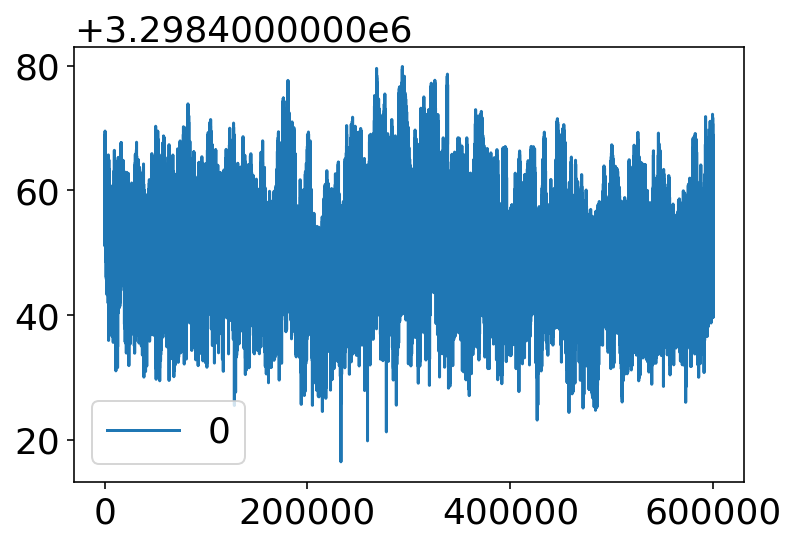

In [132]:
#plot the trace of the likelihood values to see if its sensible
for j in range(1):
    plt.plot(log_likelihood[j,10::1], label=str(j))
    
plt.legend()

(1e-07, 0.1)

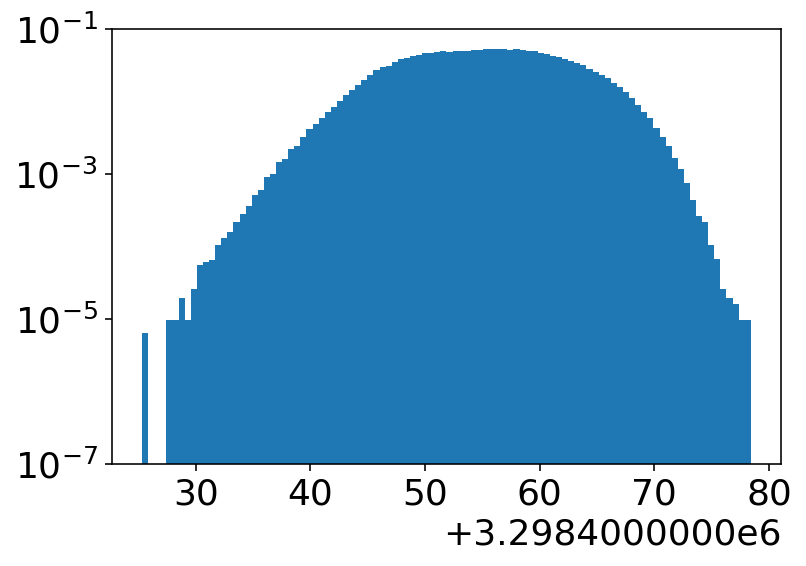

In [116]:
#also plot the histogram of likelihoods
_ = plt.hist(log_likelihood[0,10_000::1], density=True, bins=100)
plt.yscale('log')
#plt.xlim(3_302_770, 3_302_860)
plt.ylim(1e-7,1e-1)

In [133]:
#set up dictionary with true values of parameters
#set it to nan where not known

KPC2S = sc.parsec / sc.c * 1e3
SOLAR2S = sc.G / sc.c ** 3 * 1.98855e30

xxx = {"0_cos_gwtheta":np.nan,
       "0_cos_inc":np.nan,
       "0_gwphi":np.nan,
       "0_log10_fgw":np.nan,
       "0_log10_h":np.nan,
       "0_log10_mc":np.nan,
       "0_phase0":np.nan,
       "0_psi":np.nan}

singwtheta = np.sin(np.arccos(xxx['0_cos_gwtheta']))
cosgwtheta = xxx['0_cos_gwtheta']
singwphi = np.sin(xxx["0_gwphi"])
cosgwphi = np.cos(xxx["0_gwphi"])
omhat = np.array([-singwtheta * cosgwphi, -singwtheta * singwphi, -cosgwtheta])

with open('../data/quickCW_noisedict_gp_ecorr.json', 'r') as fp:
        noisedict = json.load(fp)

for j in range(len(psrs)):
    xxx[psrs[j].name+"_red_noise_gamma"] = noisedict[psrs[j].name+"_red_noise_gamma"]
    xxx[psrs[j].name+"_red_noise_log10_A"] = noisedict[psrs[j].name+"_red_noise_log10_A"]
    xxx[psrs[j].name+"_cw0_p_dist"] = 0.0
    
    ptheta = psrs[j].theta
    pphi = psrs[j].phi

    phat = np.array([np.sin(ptheta) * np.cos(pphi), np.sin(ptheta) * np.sin(pphi), np.cos(ptheta)])
    cosMu = -np.dot(omhat, phat)

    pphase = (1 + 256/5 * (10**xxx['0_log10_mc']*SOLAR2S)**(5/3) * (np.pi * 10**xxx['0_log10_fgw'])**(8/3)
              * psrs[j].pdist[0]*KPC2S*(1-cosMu)) ** (5/8) - 1
    pphase /= 32 * (10**xxx['0_log10_mc']*SOLAR2S)**(5/3) * (np.pi * 10**xxx['0_log10_fgw'])**(5/3)

    xxx[psrs[j].name+"_cw0_p_phase"] = -pphase%(2*np.pi)    
    
print(xxx)

{'0_cos_gwtheta': nan, '0_cos_inc': nan, '0_gwphi': nan, '0_log10_fgw': nan, '0_log10_h': nan, '0_log10_mc': nan, '0_phase0': nan, '0_psi': nan, 'B1855+09_red_noise_gamma': 3.6081, 'B1855+09_red_noise_log10_A': -13.7707, 'B1855+09_cw0_p_dist': 0.0, 'B1855+09_cw0_p_phase': nan, 'B1937+21_red_noise_gamma': 2.46521, 'B1937+21_red_noise_log10_A': -13.2393, 'B1937+21_cw0_p_dist': 0.0, 'B1937+21_cw0_p_phase': nan, 'B1953+29_red_noise_gamma': 2.10195, 'B1953+29_red_noise_log10_A': -14.04, 'B1953+29_cw0_p_dist': 0.0, 'B1953+29_cw0_p_phase': nan, 'J0023+0923_red_noise_gamma': 0.0896611, 'J0023+0923_red_noise_log10_A': -13.1929, 'J0023+0923_cw0_p_dist': 0.0, 'J0023+0923_cw0_p_phase': nan, 'J0030+0451_red_noise_gamma': 4.15366, 'J0030+0451_red_noise_log10_A': -14.0649, 'J0030+0451_cw0_p_dist': 0.0, 'J0030+0451_cw0_p_phase': nan, 'J0340+4130_red_noise_gamma': 1.02075, 'J0340+4130_red_noise_log10_A': -19.9246, 'J0340+4130_cw0_p_dist': 0.0, 'J0340+4130_cw0_p_phase': nan, 'J0613-0200_red_noise_gamma'

/var/folders/x2/ldvv5mnn3516rwwy1_mk51bw0000gn/T/ipykernel_92138/278087265.py:40: RuntimeWarning: invalid value encountered in double_scalars
  xxx[psrs[j].name+"_cw0_p_phase"] = -pphase%(2*np.pi)


# Parameter traces and corner plots

/var/folders/x2/ldvv5mnn3516rwwy1_mk51bw0000gn/T/ipykernel_92138/1275545563.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(i)


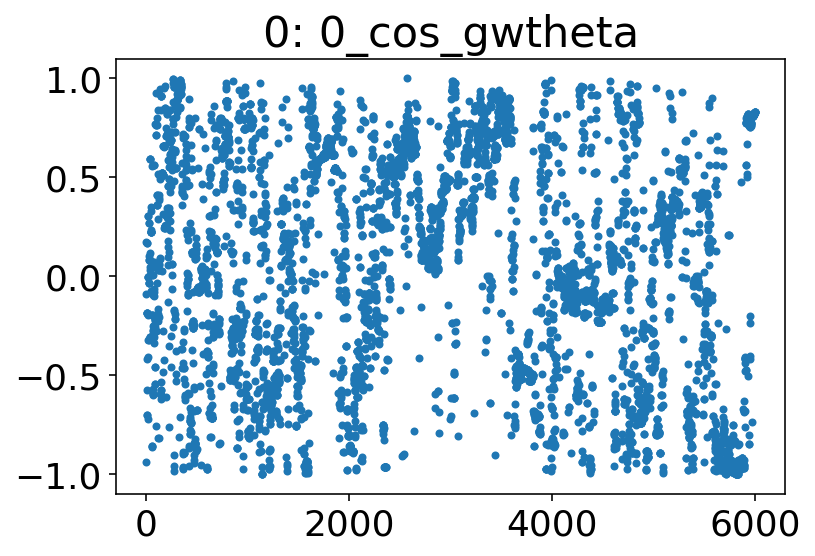

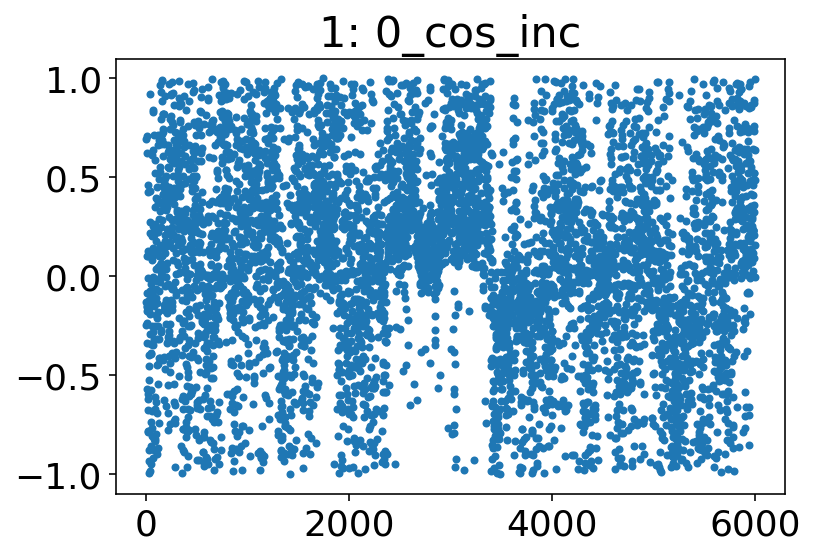

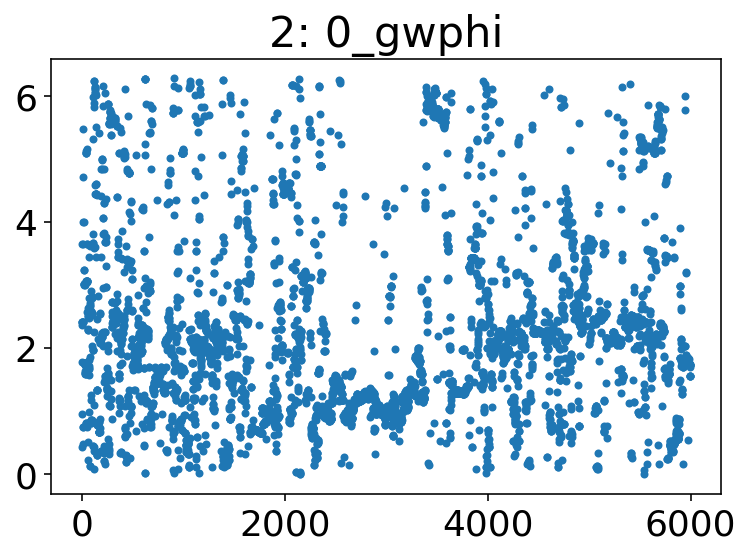

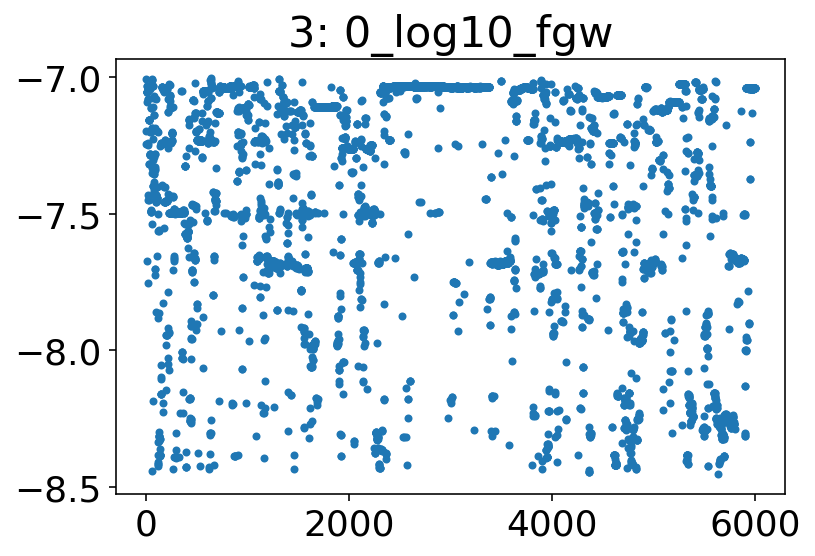

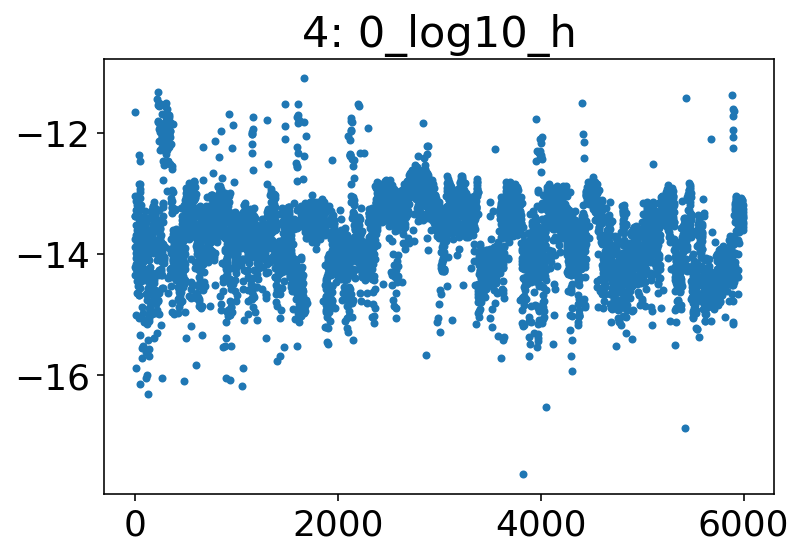

...

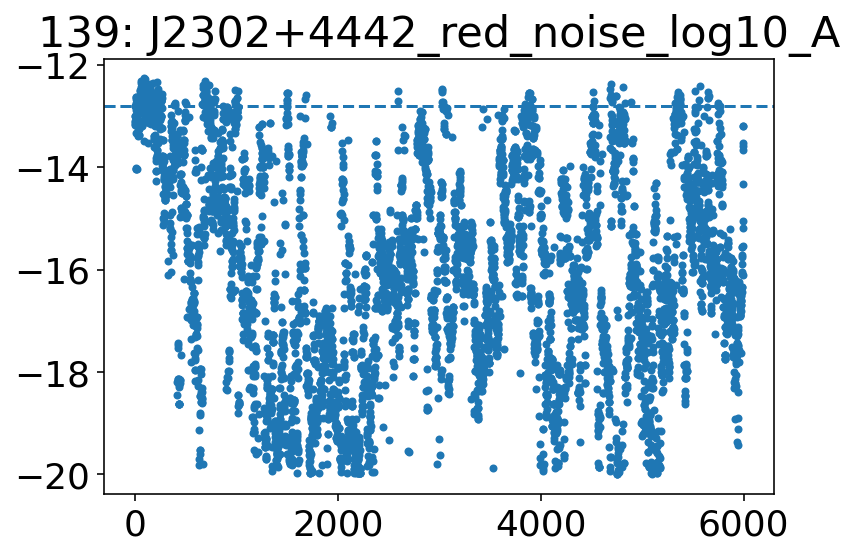

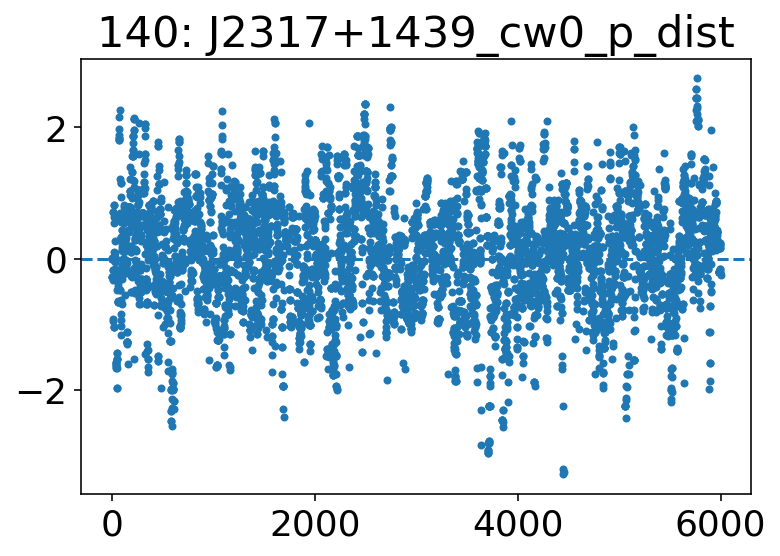

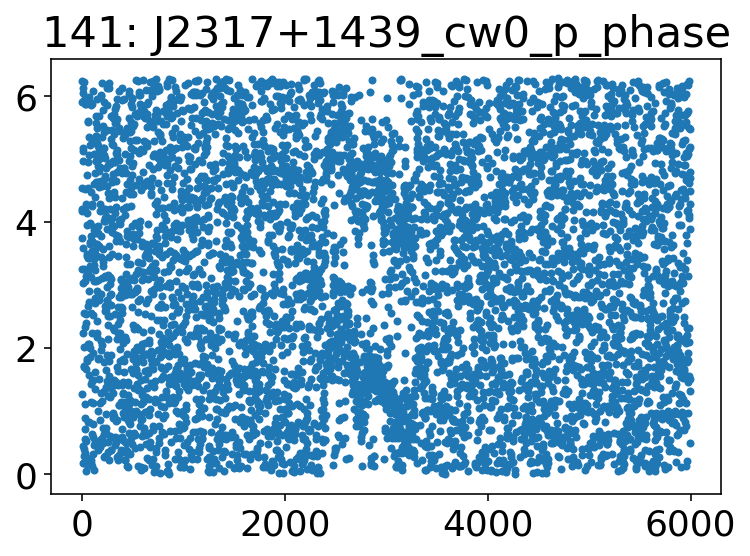

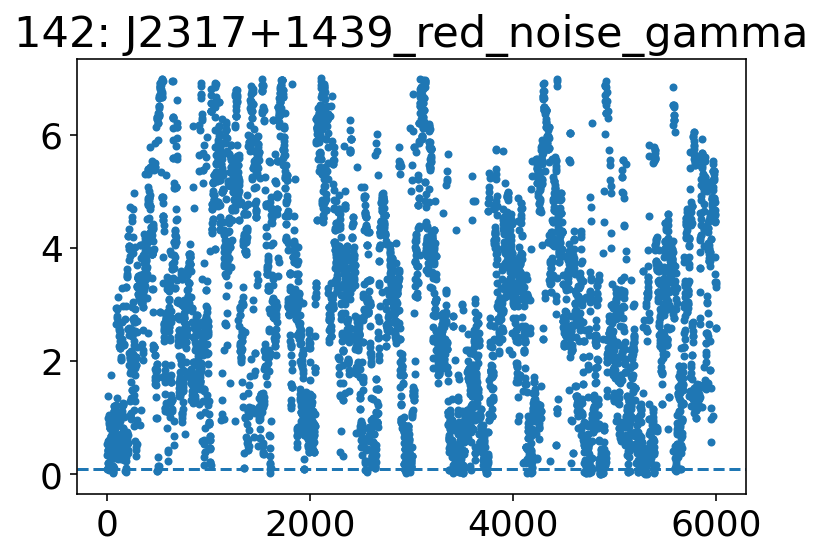

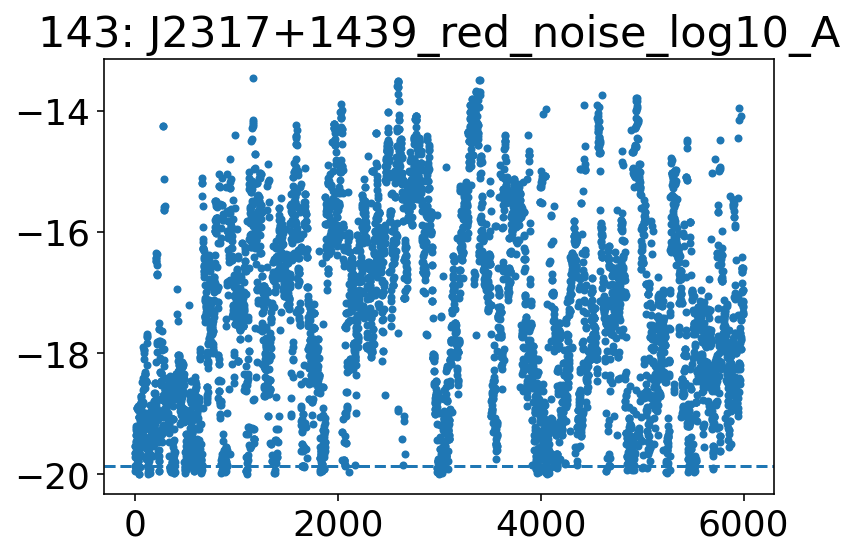

In [134]:
#plot trace of all parameters
for i, par in enumerate(par_names):
    plt.figure(i)
    plt.plot(samples_cold[::100,i], ls='', marker='.')
    plt.gca().axhline(xxx[par], ls='--')

    plt.title(str(i) + ": " + par)

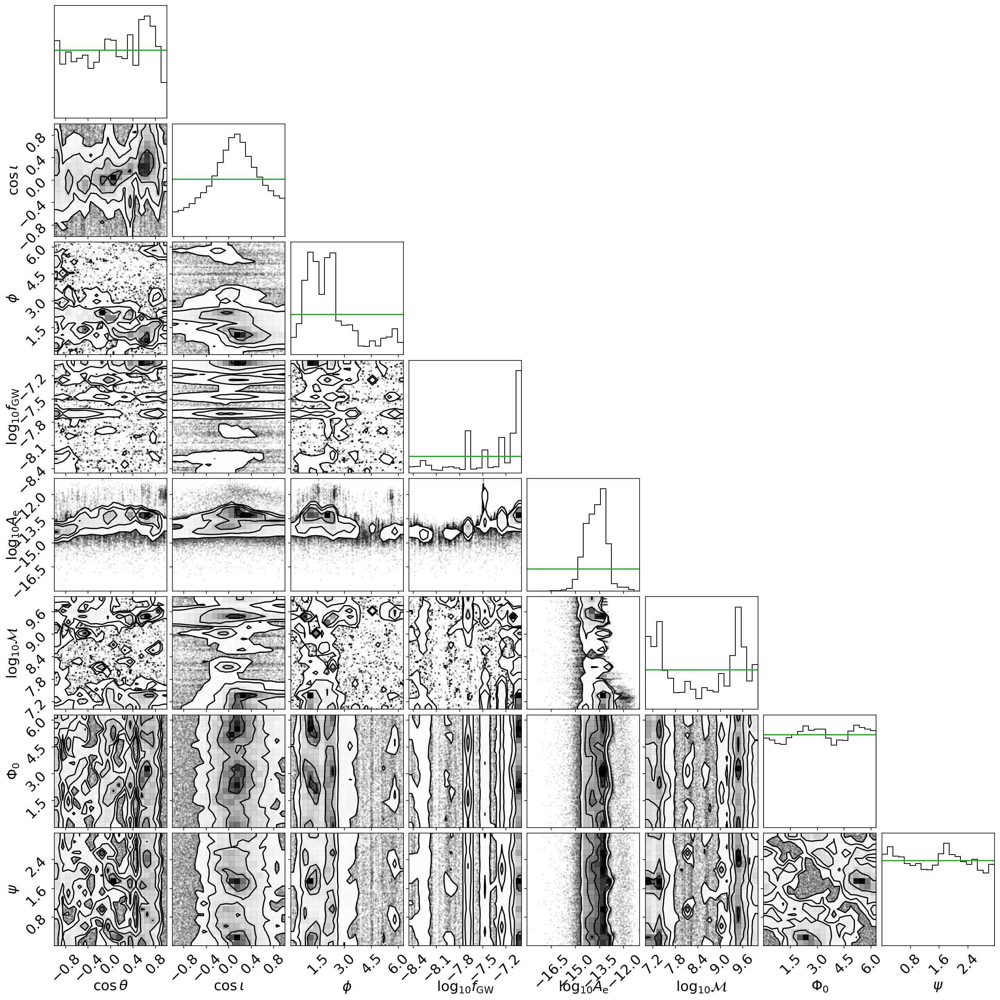

In [135]:
#corner plot of parameters common to all pulsars
corner_mask = [0, 1, 2, 3, 4, 5, 6, 7]
par_keys = ["0_cos_gwtheta", "0_cos_inc", "0_gwphi", "0_log10_fgw",
          "0_log10_h", "0_log10_mc", "0_phase0", "0_psi"]
labels = [r"$\cos \theta$", r"$\cos \iota$", r"$\phi$", r"$\log_{10} f_{\rm GW}$",
          r"$\log_{10} A_{\rm e}$", r"$\log_{10} {\cal M}$", r"$\Phi_0$", r"$\psi$"]


#set ranges
ranges = [(-1,1), (-1,1), (0,2*np.pi), (np.log10(3.5e-9),-7), (-18,-11), (7,10), (0,2*np.pi), (0,np.pi) ]

#set burnin and thinning
burnin = 100
thin = 10

truth = [xxx[key] for key in par_keys]
fig = corner.corner(samples_cold[burnin::thin,corner_mask], labels=labels, #show_titles=True, quantiles=[0.16, 0.5, 0.84],
                    truths=truth, range=ranges, hist_kwargs={"density":True})

#plot priors over 1D posteriors
for i, ax in enumerate(fig.axes):
    if i==0 or i==(len(labels)+1): #cos inc and cos theta
        Xs = np.linspace(-1,1)
        ax.plot(Xs, Xs*0+1/2, color="xkcd:green")
    elif i==2*(len(labels)+1) or i==6*(len(labels)+1): #gwphi and phase0
        Xs = np.linspace(0,2*np.pi)
        ax.plot(Xs, Xs*0+1/(2*np.pi), color="xkcd:green")
    elif i==3*(len(labels)+1): #log10_fgw
        Xs = np.linspace(np.log10(3.5e-9), -7.0)
        ax.plot(Xs, Xs*0+1/(-7-np.log10(3.5e-9)), color="xkcd:green")
    elif i==4*(len(labels)+1): #log10_A
        Xs = np.linspace(-18, -11)
        ax.plot(Xs, Xs*0+1/7, color="xkcd:green")
    elif i==5*(len(labels)+1): #log10_M_ch
        Xs = np.linspace(7, 10)
        ax.plot(Xs, Xs*0+1/3, color="xkcd:green")
    elif i==7*(len(labels)+1): #psi
        Xs = np.linspace(0,np.pi)
        ax.plot(Xs, Xs*0+1/np.pi, color="xkcd:green")

B1855+09
B1937+21


B1953+29
J0023+0923
J0030+0451
J0340+4130
J0613-0200
J0645+5158
J1012+5307


J1024-0719
J1455-3330
J1600-3053
J1614-2230
J1640+2224
J1643-1224


J1713+0747
J1738+0333
J1741+1351
J1744-1134
J1747-4036


/Users/mcdigman/opt/anaconda3/envs/Pulsar/lib/python3.9/site-packages/corner/core.py:95: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = pl.subplots(K, K, figsize=(dim, dim))


J1853+1303
J1903+0327


J1909-3744
J1910+1256
J1918-0642
J1923+2515
J1944+0907
J2010-1323
J2017+0603
J2043+1711
J2145-0750


J2214+3000


J2302+4442
J2317+1439


<Figure size 432x288 with 0 Axes>

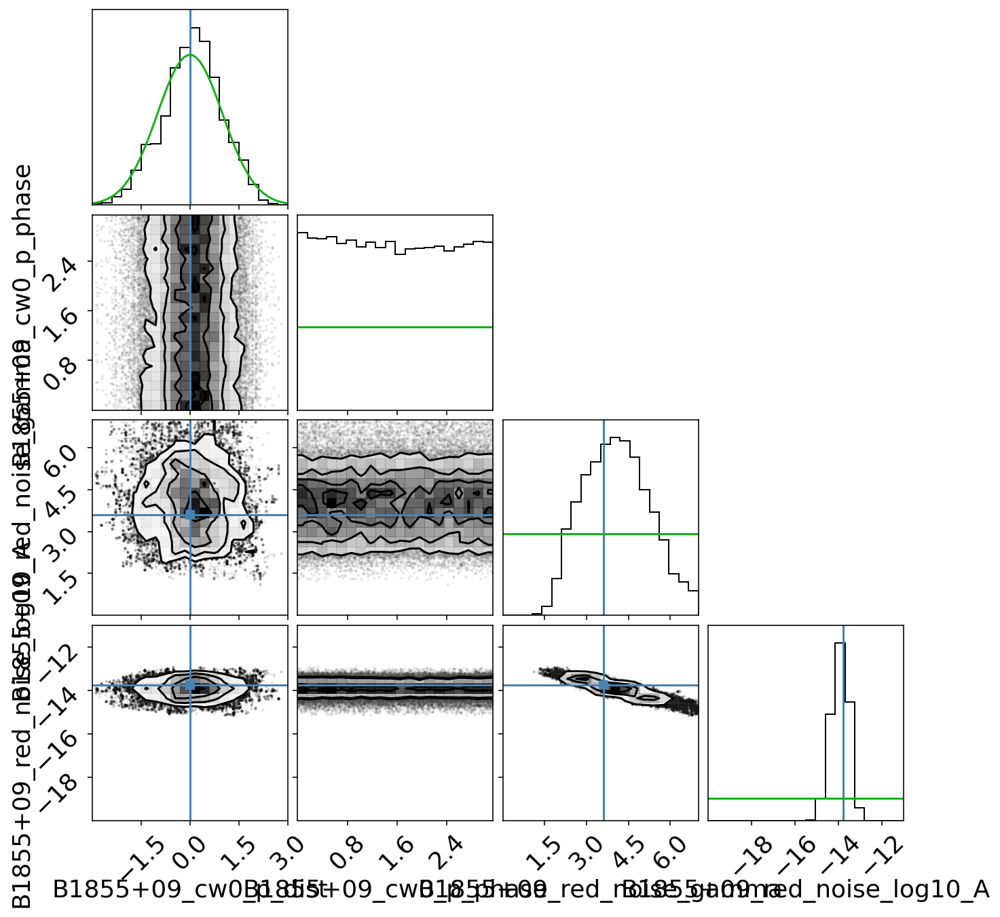

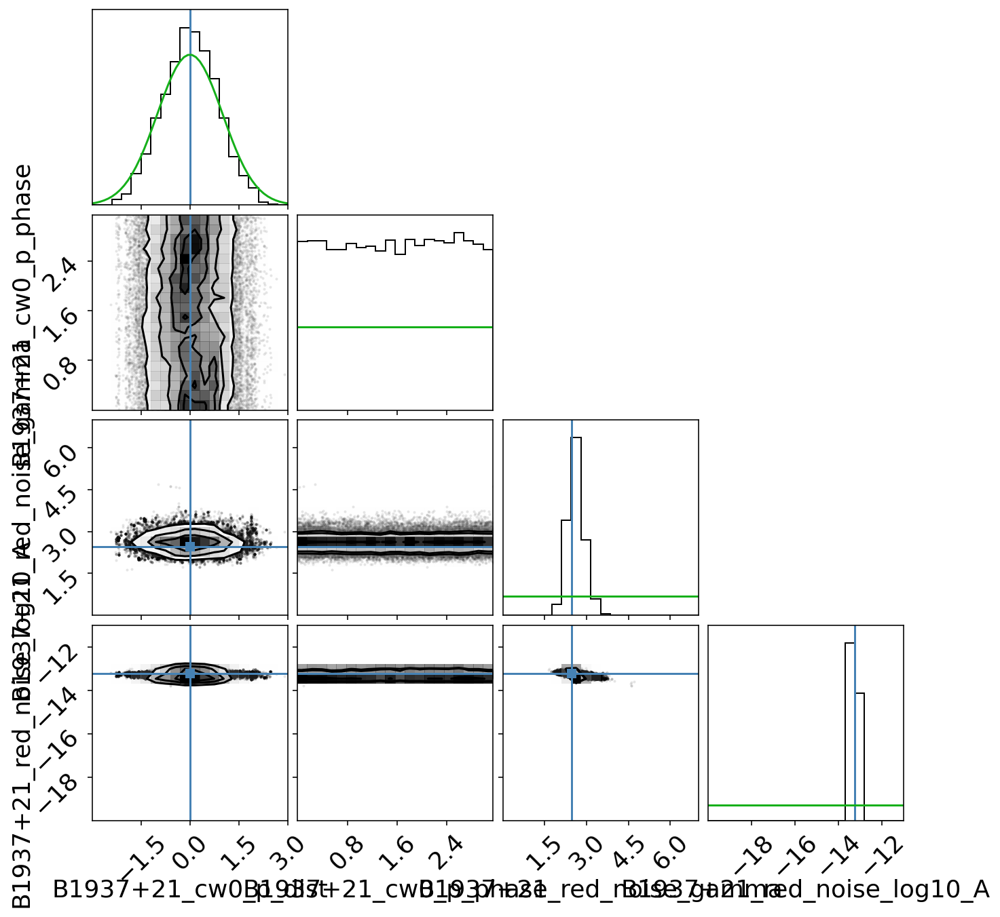

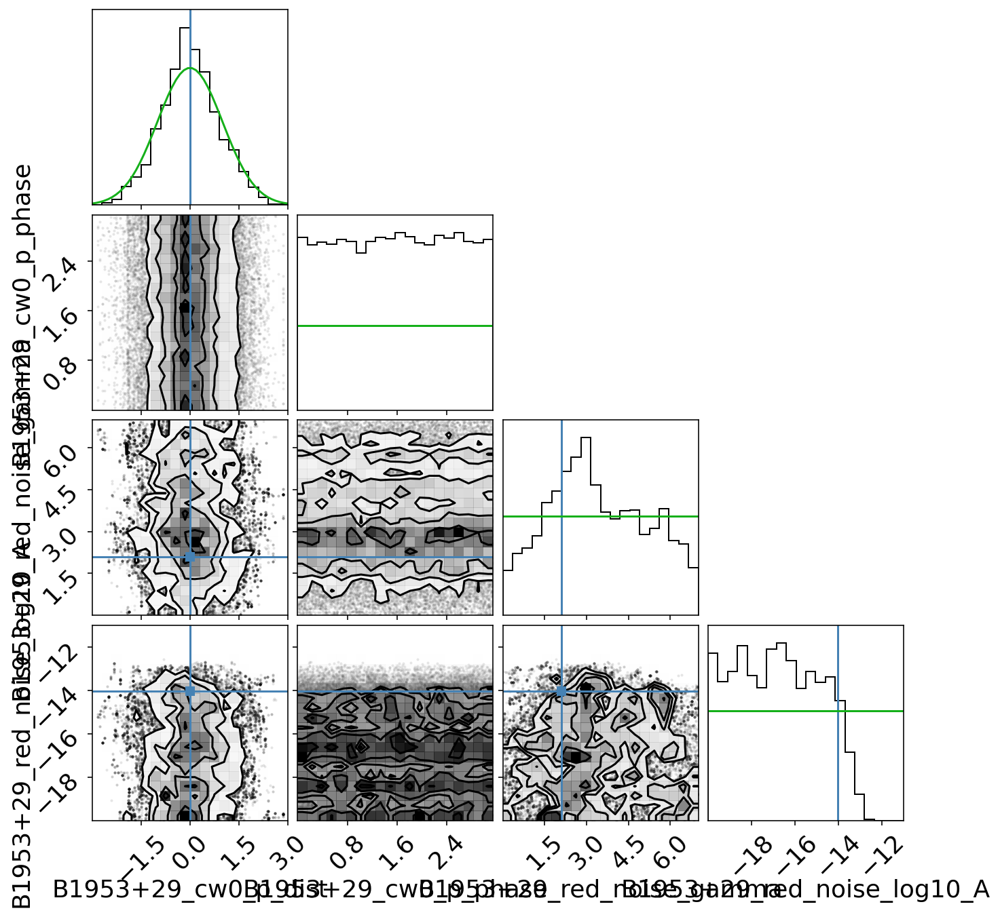

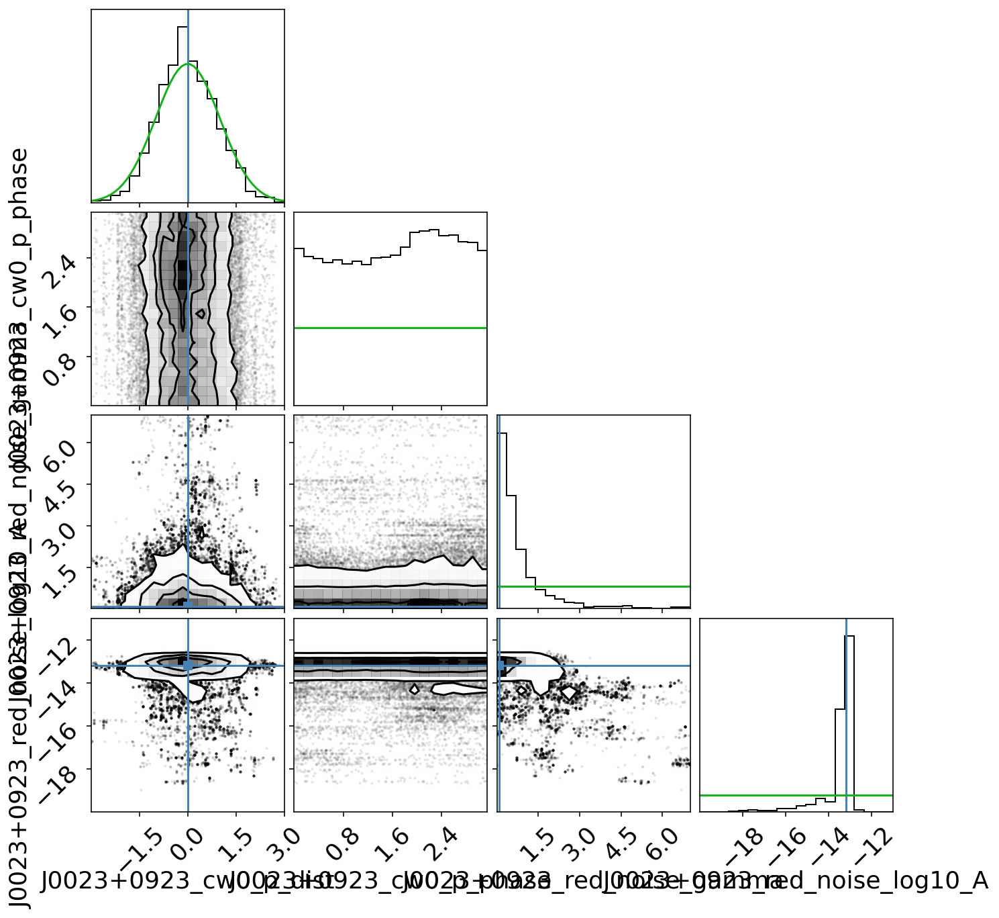

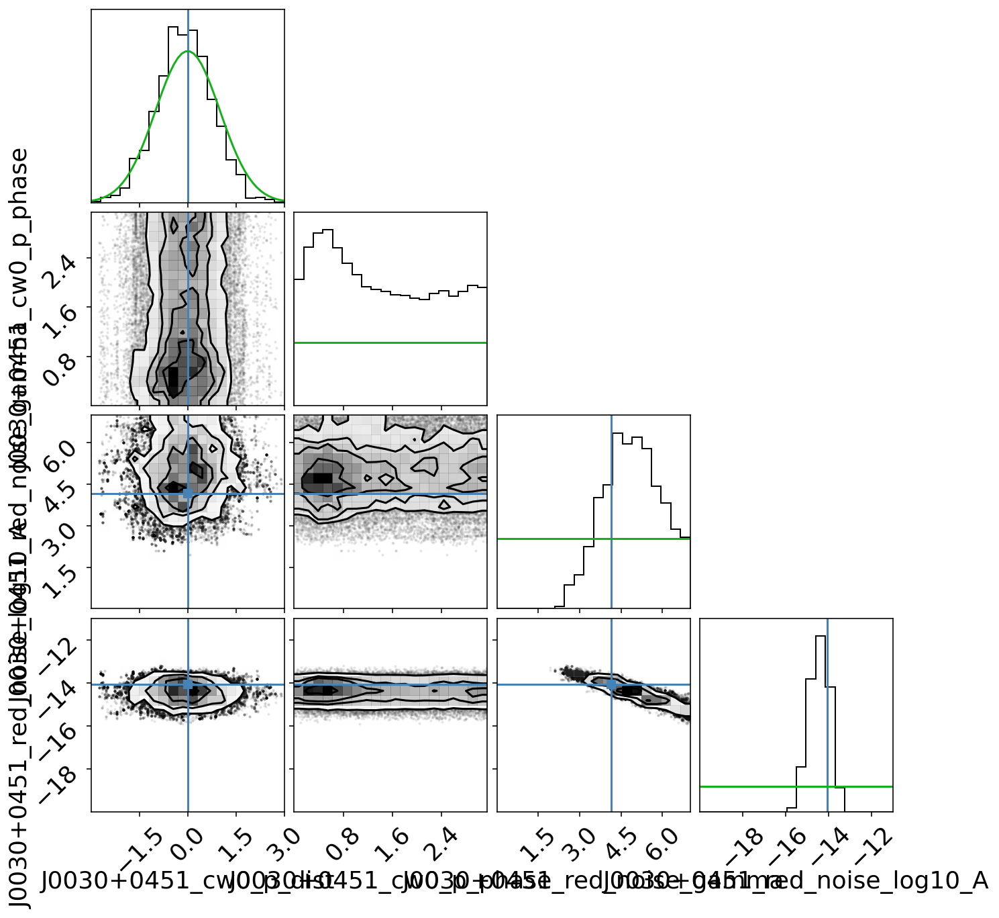

...

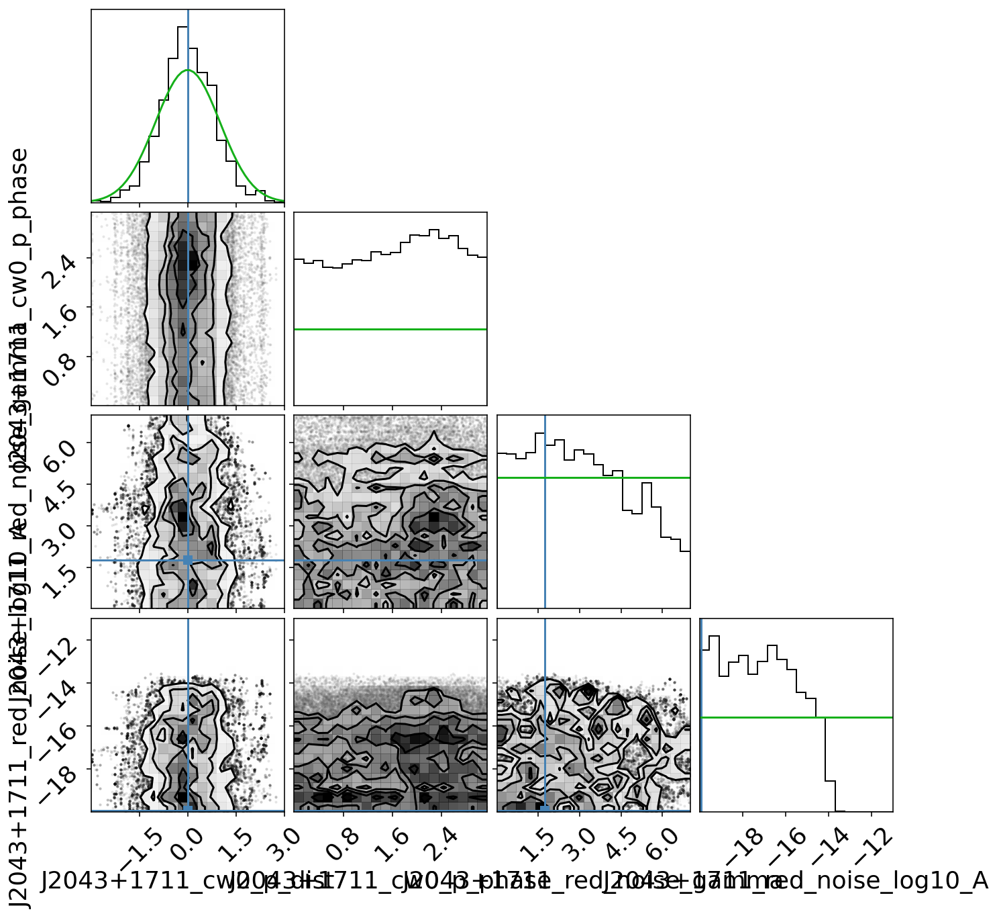

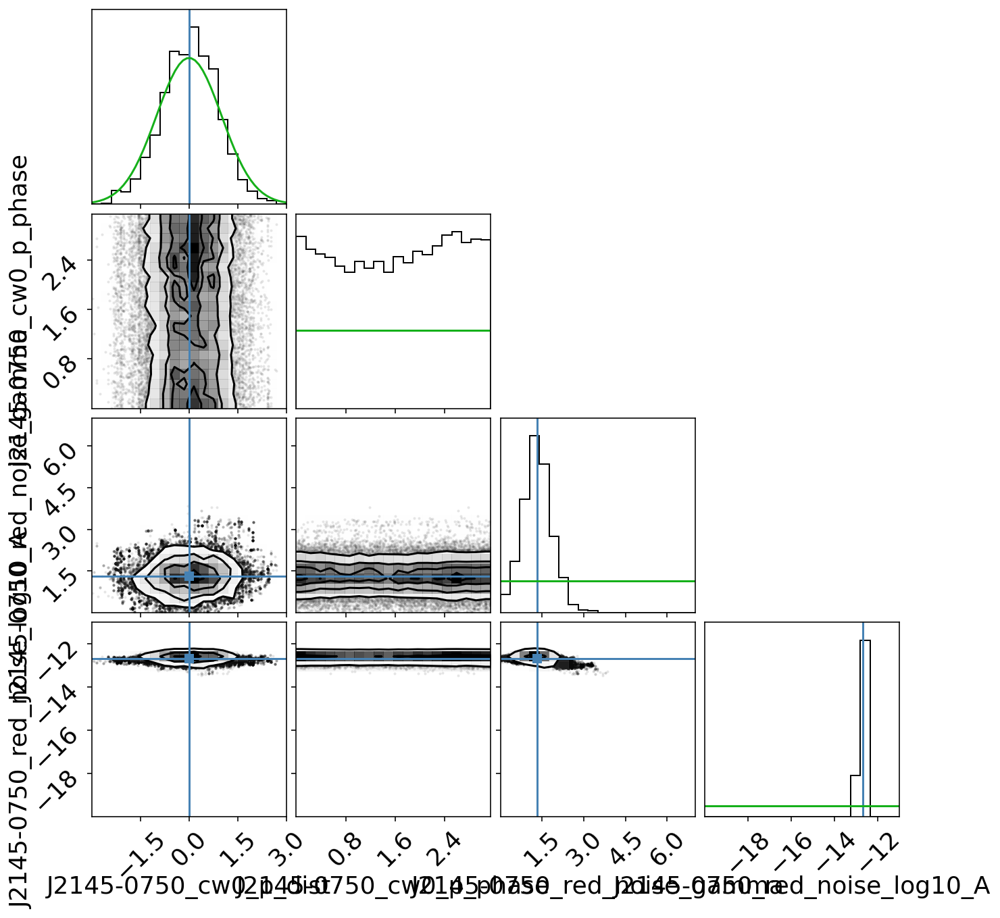

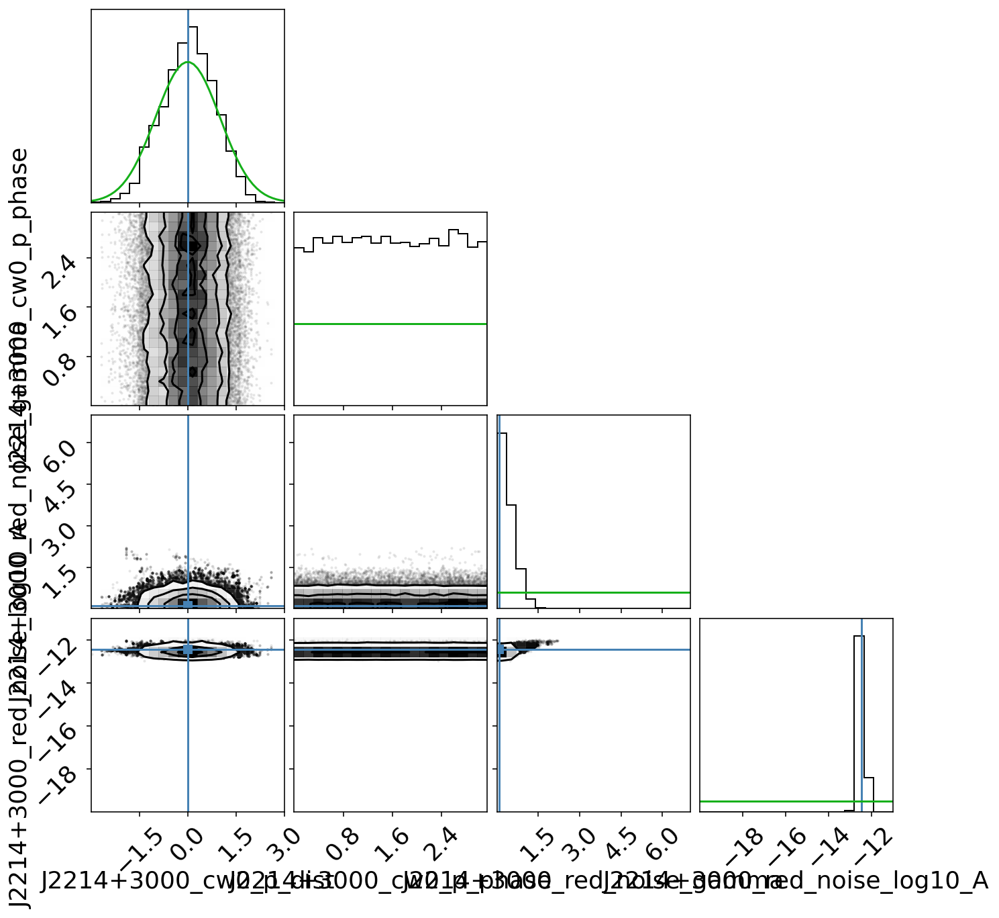

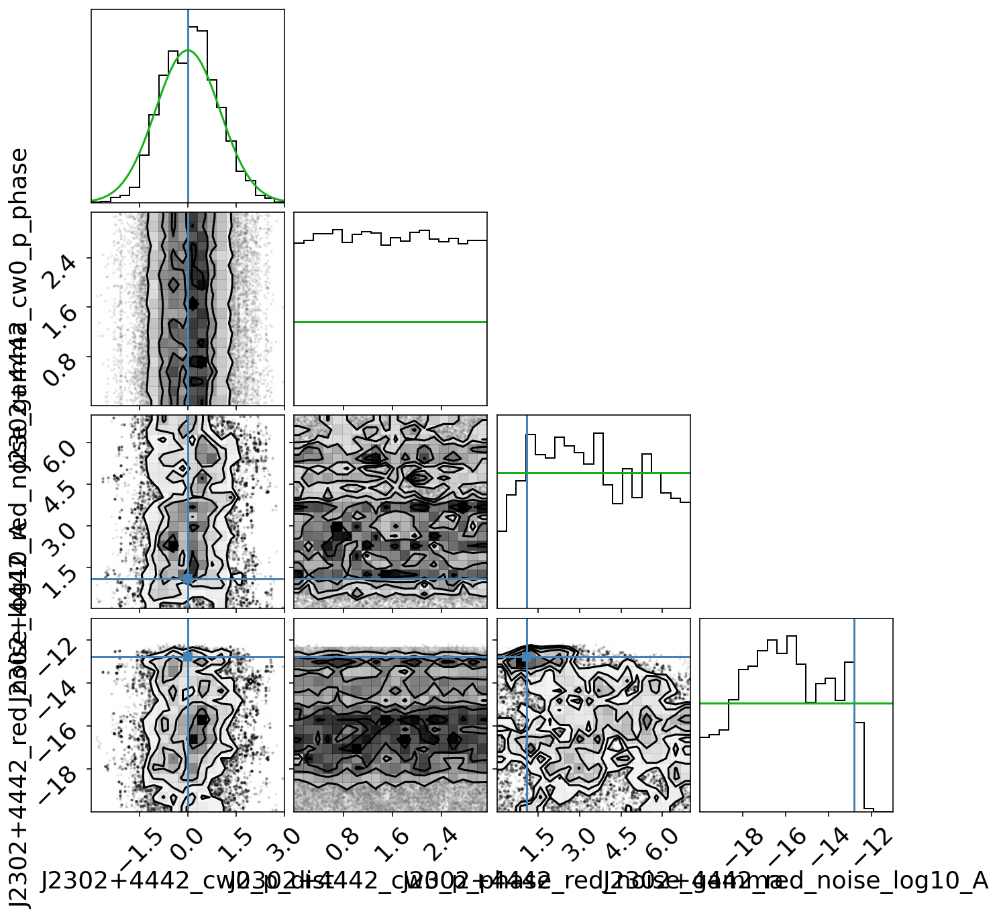

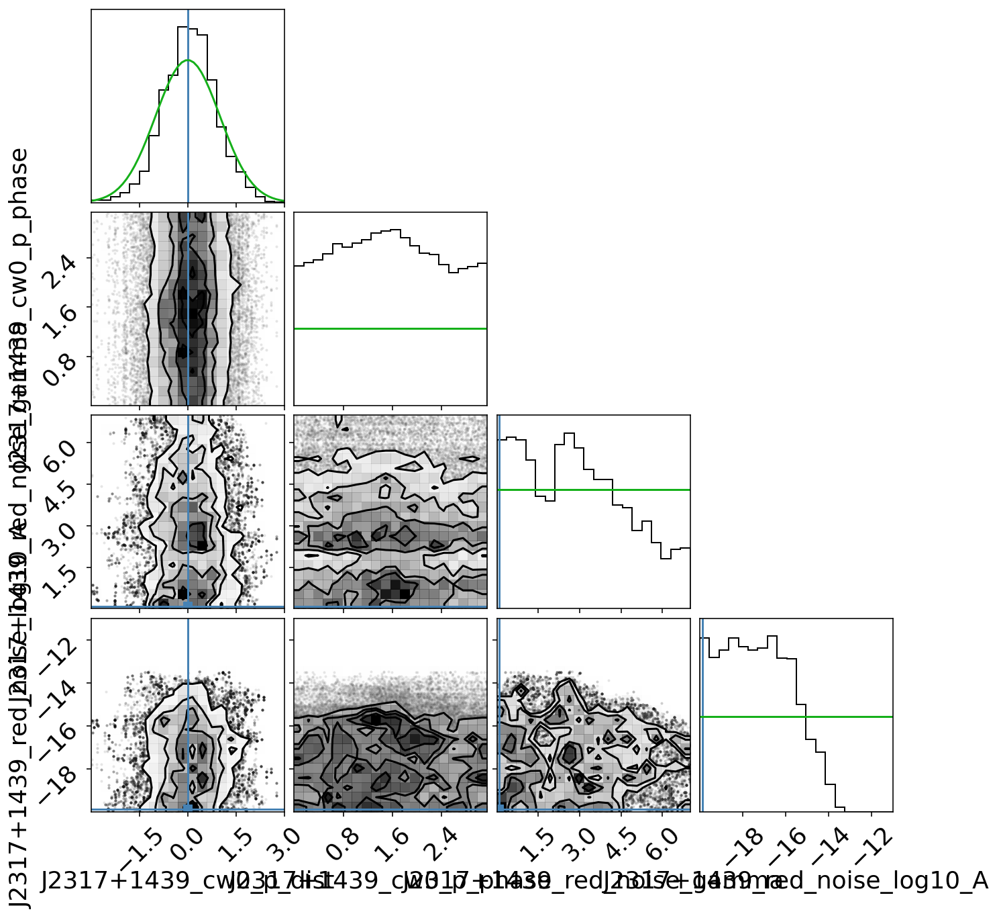

In [136]:
#corner plots for pulsar specific parameters

for I, psr in enumerate(psrs[:]):
    plt.figure(I)
    print(psr.name)
    corner_mask = [8+I*4, 9+I*4, 10+I*4, 11+I*4]
    labels = ["{0}_cw0_p_dist".format(psr.name), "{0}_cw0_p_phase".format(psr.name),
              "{0}_red_noise_gamma".format(psr.name), "{0}_red_noise_log10_A".format(psr.name)]
    #ranges = [(-3,3), (0, 2*np.pi), 0.999, 0.999]
    ranges = [(-3,3), (0, np.pi), (0,7), (-20,-11)]

    burnin = 100
    thin = 10

    truth = [xxx[key] for key in labels]
    fig = corner.corner(samples_cold[burnin::thin,corner_mask], labels=labels,
                        truths=truth, range=ranges, hist_kwargs={"density":True})

    Xs = np.linspace(0,2*np.pi)
    Ys = np.linspace(-3.0,3.0)
    Zs = np.linspace(0.0,7.0)
    Qs = np.linspace(-20.0, -11.0)

    for i, ax in enumerate(fig.axes):
        if i%(len(labels)+1)==0:
            if i%(4*(len(labels)+1))==0: #psr distance
                ax.plot(Ys, norm.pdf(Ys), color="xkcd:green")
            elif i%(4*(len(labels)+1))==1*(len(labels)+1): #psr phase
                ax.plot(Xs, Xs*0+1/(2*np.pi), color="xkcd:green")
            elif i%(4*(len(labels)+1))==2*(len(labels)+1): #rn gamma
                ax.plot(Zs, Zs*0+1/7.0, color="xkcd:green")
            elif i%(4*(len(labels)+1))==3*(len(labels)+1): #rn log_10_A
                ax.plot(Qs, Qs*0+1/9.0, color="xkcd:green")
        #print(ax.set_xlabel(i))

# UL vs. frequency

In [15]:
official_11yr_skyavg = np.loadtxt("../11yr_ul_skyavg_DE436.txt")

1
500000
[3.7500e-09 4.7610e-09 5.7833e-09 6.8168e-09 7.8617e-09 8.9182e-09
 9.9864e-09 1.1066e-08 1.2158e-08 1.3262e-08 1.4378e-08 1.5507e-08
 1.6648e-08 1.7801e-08 1.8968e-08 2.0147e-08 2.1339e-08 2.2544e-08
 2.3763e-08 2.4995e-08 2.6241e-08 2.7501e-08 2.8774e-08 3.0062e-08
 3.1364e-08 3.2680e-08 3.4010e-08 3.5356e-08 3.6716e-08 3.8091e-08
 3.9482e-08 4.0888e-08 4.2309e-08 4.3746e-08 4.5199e-08 4.6668e-08
 4.8154e-08 4.9655e-08 5.1174e-08 5.2709e-08 5.4261e-08 5.5830e-08
 5.7416e-08 5.9021e-08 6.0642e-08 6.2282e-08 6.3940e-08 6.5616e-08
 6.7311e-08 6.9024e-08 7.0756e-08 7.2508e-08 7.4278e-08 7.6069e-08
 7.7879e-08 7.9709e-08 8.1559e-08 8.3430e-08 8.5322e-08 8.7234e-08
 8.9168e-08 9.1123e-08 9.3099e-08 9.5097e-08 9.7118e-08 9.9160e-08]
[3.2444999999999993e-09, 4.24985e-09, 5.266550000000001e-09, 6.29435e-09, 7.33345e-09, 8.3841e-09, 9.4466e-09, 1.052e-08, 1.1606000000000001e-08, 1.2703999999999999e-08, 1.38135e-08, 1.4936500000000003e-08, 1.6071500000000003e-08, 1.7217499999999995e-08

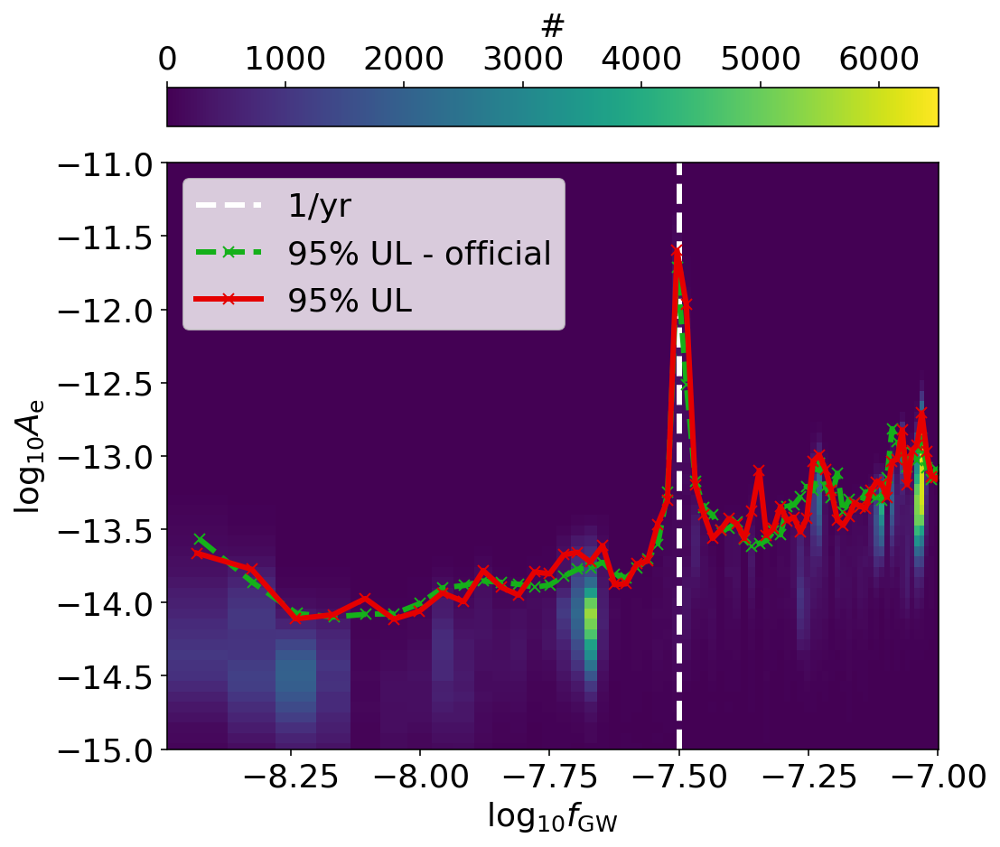

In [141]:
%%time
plt.rcParams.update({'font.size': 18})

burnin = 100_000
thin=1
#thin = 10*int(np.max([ccs[3],ccs[4]]))
print(thin)

log10_fgws = samples_cold[burnin::thin,3]
log10_hs = samples_cold[burnin::thin,4]
print(log10_fgws.size)

f_bincenters = official_11yr_skyavg[1:67,0]
#f_bincenters = official_11yr_skyavg[1:8,0]
print(f_bincenters)
f_bins = []
for i in range(f_bincenters.shape[0]-1):
    f_bins.append(f_bincenters[i]-(f_bincenters[i+1]-f_bincenters[i])/2)
f_bins.append(f_bincenters[-1]-(f_bincenters[-1]-f_bincenters[-2])/2)
f_bins.append(f_bincenters[-1]+(f_bincenters[-1]-f_bincenters[-2])/2)
print(f_bins)

log10_h_bins = np.linspace(-18,-11,100)

plt.figure(figsize=(8,7))
#h, xedges, yedges, _ = plt.hist2d(log10_fgws, log10_hs, bins=50, range=[[np.log10(3.5e-9),-7],[-18,-11]])
#h, xedges, yedges, _ = plt.hist2d(log10_fgws, log10_hs, bins=100, range=[[np.log10(3.5e-9),-7],[-15.5,-11]],
#                                  weights=log10_fgws*0+1/60.0)
h, xedges, yedges, _ = plt.hist2d(log10_fgws, log10_hs, bins=[np.log10(f_bins), log10_h_bins])

#make bin centers
bincenters = []
for i in range(xedges.size-1):
    bincenters.append((xedges[i+1]+xedges[i])/2)
bincenters = np.array(bincenters)

#print(xedges)
#print(bincenters)

freq_idx = np.digitize(log10_fgws, xedges)
#plt.scatter(log10_fgws[np.where(freq_idx==1)], log10_hs[np.where(freq_idx==1)])

N_bootstrap = 1000
#N_resample = 100

UL_freq = np.zeros(bincenters.size)
#UL_freq_reweight = np.zeros(bincenters.size)
#UL_freq_reweight_low = np.zeros(bincenters.size)
#UL_freq_reweight_high = np.zeros(bincenters.size)
UL_freq_error = np.zeros(bincenters.size)
for i in range(bincenters.size):
    hs = 10**log10_hs[np.where(freq_idx==i+1)]
    UL_freq[i] = np.percentile(hs, 95)

    N_inbin = hs.shape[0]
    N_resample = int(N_inbin)

    print(N_inbin)

    #N_batch = int(N_inbin**(1/5))
    N_batch = 10
    print(N_batch)
    
    hs_batches = []
    for K in range(N_batch):
        hs_batches.append(hs[K*int(N_inbin/N_batch):(K+1)*int(N_inbin/N_batch)])

    ULs = np.zeros(N_bootstrap)
    for k in range(N_bootstrap):
        IDXS = np.random.choice(N_batch, size=N_batch, replace=True)
        hs_shuffle = np.block([hs_batches[J] for J in IDXS])
        ULs[k] = np.percentile(hs_shuffle, 95)
    
    UL_freq_error[i] = np.std(ULs)
    

plt.gca().axvline(x=-np.log10(3600*24*365.24), ls='--', lw=3, color='white', label='1/yr')
#plt.plot(bincenters, UL_freq, ls='-', lw=3, marker='.', color="xkcd:red", label="95% UL")
plt.errorbar(bincenters, np.log10(UL_freq), ls='-', lw=3, marker='x', color="xkcd:red", label="95% UL")
#plt.fill_between(bincenters, UL_freq_reweight_low, UL_freq_reweight_high,
#                 color="xkcd:red", alpha=0.3, label="95% UL")
plt.plot(np.log10(official_11yr_skyavg[1:67,0]), np.log10(official_11yr_skyavg[1:67,1]),
         ls='--', lw=3, marker='x', color="xkcd:green", label="95% UL - official")
#plt.plot(np.log10(official_11yr_skyavg[:,0]), np.log10(official_11yr_skyavg[:,2]),
#         ls='--', lw=3, marker='.', color="xkcd:purple", label="95% UL - official2")
plt.ylim(-15,-11)
plt.xlabel(r"$\log_{10} f_{\rm GW}$")
plt.ylabel(r"$\log_{10} A_{\rm e}$")

cbar = plt.colorbar(location='top')
cbar.set_label('#')

plt.legend(loc=2)

plt.tight_layout()  # otherwise the right y-label is slightly clipped
#plt.savefig("Figs/UL_vs_freq.png", dpi=300)
#plt.savefig("Figs/UL_vs_freq_new_seed.png", dpi=300)

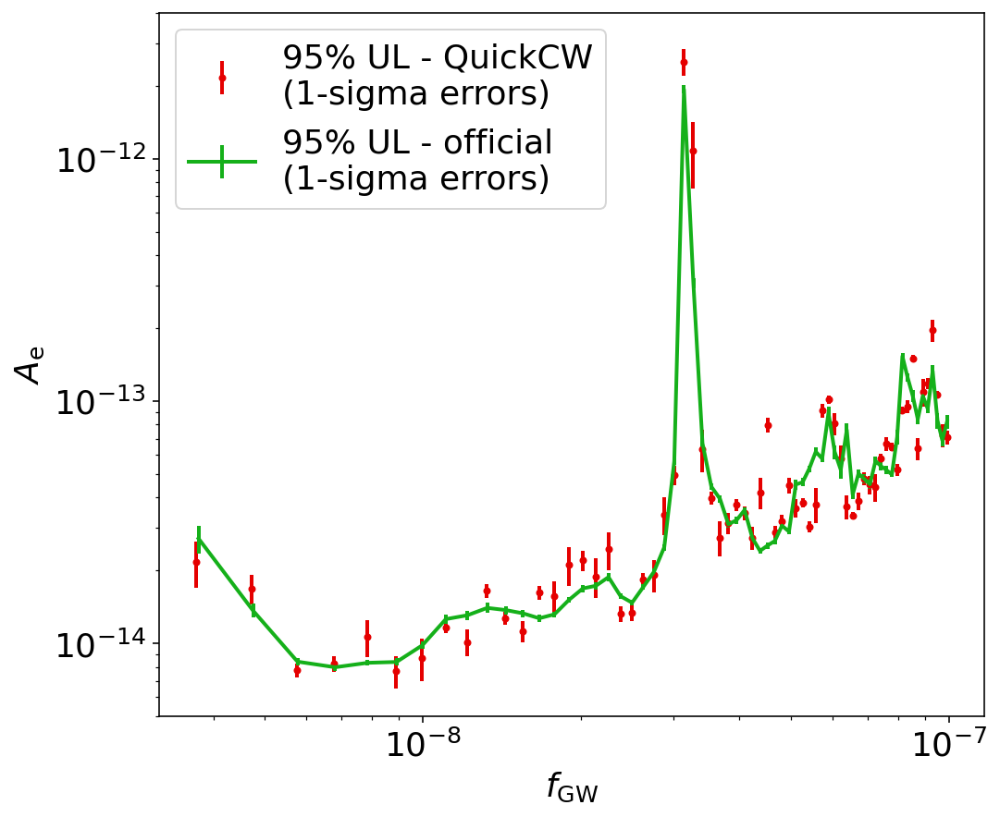

In [143]:
plt.figure(figsize=(8,7))

plt.errorbar(10**bincenters, UL_freq, yerr=UL_freq_error,
             ls='', lw=2, marker='.', alpha=1.0, color="xkcd:red", label="95% UL - QuickCW\n(1-sigma errors)")

plt.errorbar(official_11yr_skyavg[1:67,0], official_11yr_skyavg[1:67,1],
             yerr=official_11yr_skyavg[1:67,2],
             ls='-', lw=2, marker='', color="xkcd:green", label="95% UL - official\n(1-sigma errors)")

plt.xscale('log')
plt.yscale('log')
plt.ylim(5e-15,4e-12)
plt.xlabel(r"$f_{\rm GW}$")
plt.ylabel(r"$A_{\rm e}$")

plt.legend(loc=2)

In [62]:
np.unique(samples_cold[:,0],return_counts=True)

(array([-9.99705136e-01, -9.99643862e-01, -9.98305261e-01, -9.97778177e-01,
        -9.94697332e-01, -9.90531206e-01, -9.86421585e-01, -9.85620201e-01,
        -9.71610129e-01, -9.70211625e-01, -9.70166564e-01, -9.66733336e-01,
        -9.63748455e-01, -9.62364793e-01, -9.62095797e-01, -9.60261464e-01,
        -9.58498955e-01, -9.58124340e-01, -9.54348266e-01, -9.52740908e-01,
        -9.51238751e-01, -9.50985014e-01, -9.46781993e-01, -9.42345381e-01,
        -9.40582037e-01, -9.39411819e-01, -9.37089264e-01, -9.36055481e-01,
        -9.35809910e-01, -9.33406651e-01, -9.33018982e-01, -9.33003306e-01,
        -9.32312965e-01, -9.27930772e-01, -9.25851285e-01, -9.16661501e-01,
        -9.15103316e-01, -9.14178550e-01, -9.10692811e-01, -8.98088276e-01,
        -8.98026526e-01, -8.96615624e-01, -8.93292069e-01, -8.77663612e-01,
        -8.75749707e-01, -8.71846259e-01, -8.71824980e-01, -8.66231441e-01,
        -8.66209567e-01, -8.61292541e-01, -8.53215575e-01, -8.51044238e-01,
        -8.5